In [132]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import confusion_matrix,f1_score
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import TensorBoard

In [ ]:
df = pd.read_csv('./data/banknotes.csv')
df.head()

In [3]:
df['class'].value_counts()

0    762
1    610
Name: class, dtype: int64

In [4]:
 df['class'].value_counts()[0]/len(df)

0.5553935860058309

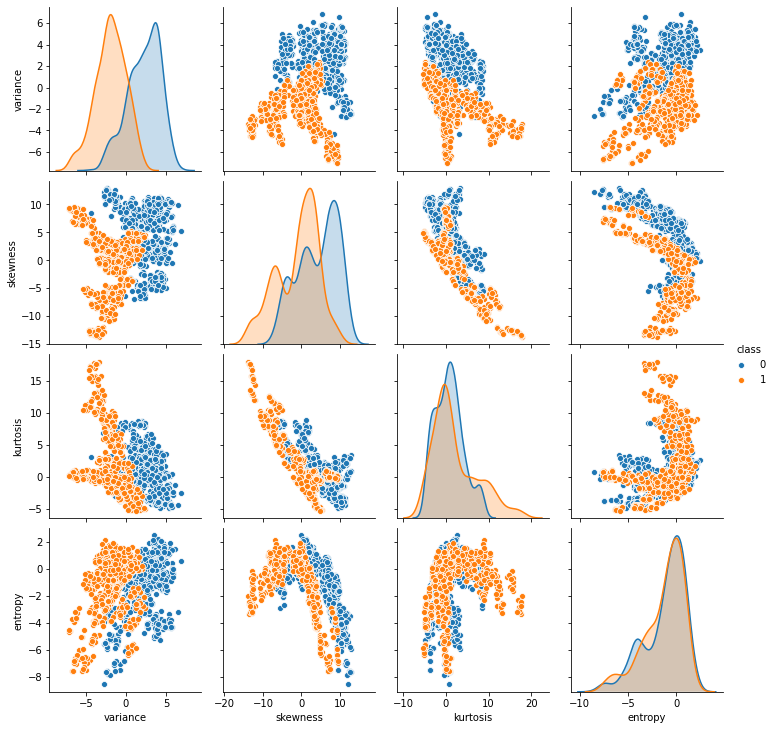

In [5]:
sns.pairplot(df, hue="class")

In [6]:
model = RandomForestClassifier()

In [7]:
X = df.drop('class', axis=1).values
y = df['class'].values

In [8]:
cross_val_score(model, X, y)

array([0.99272727, 0.98909091, 0.98905109, 0.99635036, 0.99635036])

In [10]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=42)


In [11]:
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.9951456310679612

In [21]:
model = Sequential()
model.add(Dense(1, kernel_initializer='ones',input_shape=(4,), activation='sigmoid'))
model.compile(optimizer='sgd',
                       loss='binary_crossentropy',
                       metrics=['accuracy'])

In [22]:
weights = model.get_weights()

In [23]:
losses = []
idx = range(len(X_train) - 1)
for i in idx:
    loss, _ = model.train_on_batch(X_train[i:i+1],
                                y_train[i:i+1])
    losses.append(loss)

Text(0, 0.5, 'Loss')

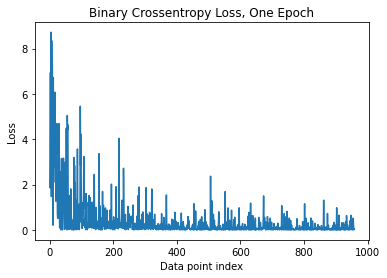

In [24]:
plt.plot(losses)
plt.title('Binary Crossentropy Loss, One Epoch')
plt.xlabel('Data point index')
plt.ylabel('Loss')

In [26]:
model.set_weights(weights)
B=16
batch_idx = np.arange(0, len(X_train) - B, B)
batch_losses = []
for i in batch_idx:
    loss, _ = model.train_on_batch(X_train[i:i+B],y_train[i:i+B])
    batch_losses.append(loss)

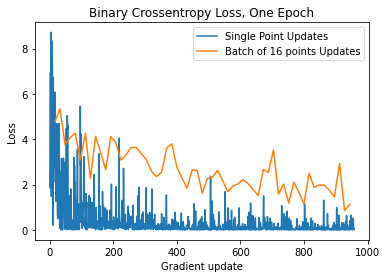

In [27]:
plt.plot(idx, losses)
plt.plot(batch_idx + B, batch_losses)
plt.title('Binary Crossentropy Loss, One Epoch')
plt.xlabel('Gradient update')
plt.ylabel('Loss')
plt.legend(['Single Point Updates','Batch of 16 points Updates'])

In [28]:
model.set_weights(weights)
history = model.fit(X_train, y_train, batch_size=16,
                             epochs=20, verbose=0)

In [30]:
result = model.evaluate(X_test, y_test)
"Test accuracy: {:0.2f} %".format(result[1]*100)

13/13 [==============================] - 0s 728us/step - loss: 0.1119 - accuracy: 0.9782


'Test accuracy: 97.82 %'

In [31]:
dflist = []
learning_rates = [0.01, 0.05, 0.1, 0.5]
for lr in learning_rates:
    model.compile(loss='binary_crossentropy',
                optimizer=SGD(lr=lr),
                metrics=['accuracy'])
    model.set_weights(weights)
    h = model.fit(X_train, y_train, batch_size=16,
              epochs=10, verbose=0)
    dflist.append(pd.DataFrame(h.history,
                           index=h.epoch))
    print("Done: {}".format(lr))    

Done: 0.01
Done: 0.05
Done: 0.1
Done: 0.5


In [32]:
historydf = pd.concat(dflist, axis=1)
historydf

,loss,accuracy,loss,accuracy,loss,accuracy,loss,accuracy
0,2.625122,0.233333,0.972171,0.679167,0.588425,0.810417,0.340626,0.913542
1,0.982966,0.552083,0.176172,0.943750,0.114062,0.967708,0.047753,0.985417
2,0.484643,0.798958,0.124602,0.968750,0.087188,0.972917,0.044596,0.980208
3,0.330126,0.883333,0.103191,0.970833,0.073510,0.978125,0.040942,0.981250
4,0.258719,0.908333,0.090936,0.973958,0.064501,0.986458,0.047612,0.981250
5,0.217366,0.927083,0.081925,0.977083,0.058740,0.983333,0.031753,0.989583
6,0.190044,0.938542,0.075646,0.977083,0.054577,0.984375,0.042687,0.984375
7,0.171042,0.943750,0.070173,0.983333,0.050475,0.985417,0.028814,0.988542
8,0.156833,0.951042,0.065976,0.982292,0.047517,0.986458,0.027064,0.990625
9,0.145623,0.955208,0.062774,0.983333,0.044942,0.985417,0.027343,0.990625


In [33]:
metrics_reported = dflist[0].columns
idx = pd.MultiIndex.from_product([learning_rates,
                                metrics_reported],
                                names=['learning_rate','metric'])
historydf.columns = idx
historydf

learning_rate      0.01                0.05                0.10            \
metric             loss  accuracy      loss  accuracy      loss  accuracy   
0              2.625122  0.233333  0.972171  0.679167  0.588425  0.810417   
1              0.982966  0.552083  0.176172  0.943750  0.114062  0.967708   
2              0.484643  0.798958  0.124602  0.968750  0.087188  0.972917   
3              0.330126  0.883333  0.103191  0.970833  0.073510  0.978125   
4              0.258719  0.908333  0.090936  0.973958  0.064501  0.986458   
5              0.217366  0.927083  0.081925  0.977083  0.058740  0.983333   
6              0.190044  0.938542  0.075646  0.977083  0.054577  0.984375   
7              0.171042  0.943750  0.070173  0.983333  0.050475  0.985417   
8              0.156833  0.951042  0.065976  0.982292  0.047517  0.986458   
9              0.145623  0.955208  0.062774  0.983333  0.044942  0.985417   

learning_rate      0.50            
metric             loss  accuracy  
0              0.340626  0.913542  
1              0.047753  0.985417  
2              0.044596  0.980208  
3              0.040942  0.981250  
4              0.047612  0.981250  
5              0.031753  0.989583  
6              0.042687  0.984375  
7              0.028814  0.988542  
8              0.027064  0.990625  
9              0.027343  0.990625

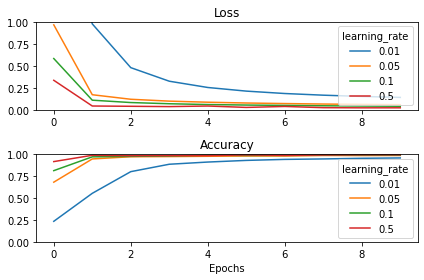

In [34]:
ax = plt.subplot(211)
hxs = historydf.xs('loss', axis=1, level='metric')
hxs.plot(ylim=(0,1), ax=ax)
plt.title("Loss")
ax = plt.subplot(212)
hxs = historydf.xs('accuracy', axis=1, level='metric')
hxs.plot(ylim=(0,1), ax=ax)
plt.title("Accuracy")
plt.xlabel("Epochs")
plt.tight_layout()

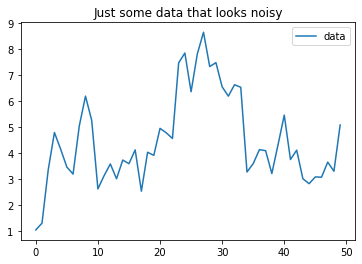

In [4]:
points = pd.DataFrame([1.04, 1.30, 3.35, 4.79, 4.15,
                                3.46, 3.19, 5.04, 6.19, 5.26,
                                2.62, 3.13, 3.58, 3.01, 3.73,
                                3.59, 4.12, 2.53, 4.03, 3.91,
                                4.95, 4.78, 4.56, 7.47, 7.85,
                                6.36, 7.81, 8.65, 7.33, 7.48,
                                6.55, 6.19, 6.63, 6.53, 3.27,
                                3.59, 4.13, 4.09, 3.21, 4.32,
                                5.46, 3.75, 4.11, 3.01, 2.82,
                                3.08, 3.07, 3.65, 3.30, 5.08],
                               columns=['data'])
points.plot(title='Just some data that looks noisy')
plt.show()

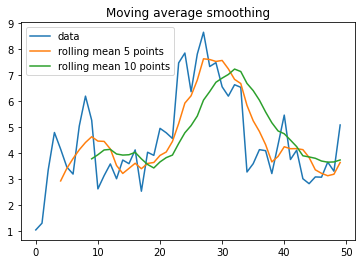

In [5]:
points['rolling mean 5 points'] = points['data'].rolling(5).mean()
points['rolling mean 10 points'] = points['data'].rolling(10).mean()
points.plot(title='Moving average smoothing')
plt.show()

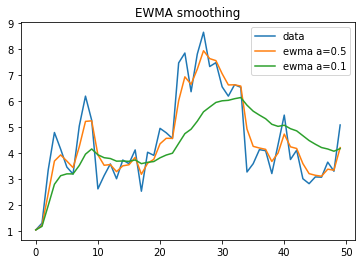

In [6]:
points['ewma a=0.5'] = points['data'].ewm(alpha=0.5).mean()
points['ewma a=0.1'] = points['data'].ewm(alpha=0.1).mean()
cols_ = ['data', 'ewma a=0.5', 'ewma a=0.1']
points[cols_].plot(title='EWMA smoothing')
plt.show()

In [40]:
df=pd.read_csv("data/winequality-red.csv",sep=";")

In [39]:
df["quality"].value_counts()

5    681
6    638
7    199
4     53
8     18
3     10
Name: quality, dtype: int64

In [41]:
df["quality"] = df["quality"].apply(lambda x: x-3)
df["quality"].value_counts()


2    681
3    638
4    199
1     53
5     18
0     10
Name: quality, dtype: int64

In [42]:
df.columns

Index(['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar',
       'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density',
       'pH', 'sulphates', 'alcohol', 'quality'],
      dtype='object')

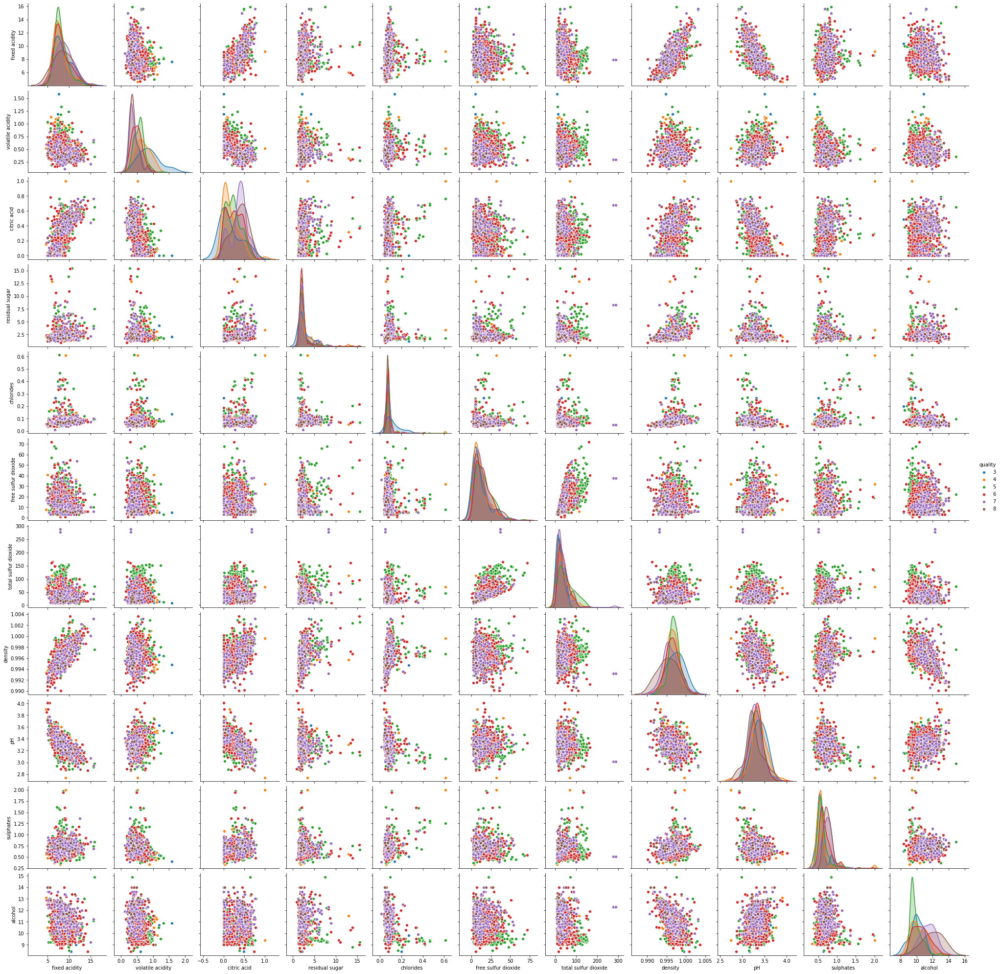

In [14]:
sns.pairplot(df,hue="quality")

In [43]:
scaler = MinMaxScaler()
X = scaler.fit_transform(df.loc[:,"fixed acidity":"alcohol"])
y= df["quality"]

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2)

In [168]:
def build_model(X,y,lr=0.1,epochs=20):
    model = Sequential()
    model.add(Dense(15,input_dim=X.shape[1],activation='relu',kernel_initializer='he_normal'))
    model.add(Dense(8,activation='relu'))
    model.add(Dense(6,activation='softmax'))
    
    earlystopper = EarlyStopping(
             monitor='loss', min_delta=0, patience=1,
             verbose=1, mode='auto')
    tensorboard = TensorBoard(
             log_dir='/Users/rajagopal/git/tensorboard/')
    callbacks_ = [earlystopper, tensorboard]


    model.compile(
        optimizer=tf.keras.optimizers.RMSprop(learning_rate=lr),
        loss='categorical_crossentropy', metrics ='accuracy')
    history = model.fit(X,pd.get_dummies(y), epochs=epochs,verbose=0,callbacks=callbacks_)
    return pd.DataFrame(history.history)


In [159]:
def print_score(history,X,y_true):
    pred =pd.DataFrame(model.predict(X))
    y_pred =pred.idxmax(axis=1)
    print(confusion_matrix(y_true, y_pred))
    print(f"F1 score: {f1_score(y_true,y_pred,average='weighted',zero_division=0)}")
    print(f"Accuracy: {history['accuracy'].mean()}")

In [169]:
history = build_model(X_train,y_train,0.1,40)
print_score(history,X_test,y_test)

Epoch 00009: early stopping
[[ 0  0  2  0  0  0]
 [ 0  0  7  7  0  0]
 [ 0  1 98 43  2  0]
 [ 0  0 29 79 10  0]
 [ 0  0  1 27 11  0]
 [ 0  0  0  1  2  0]]
F1 score: 0.5676371711723551
Accuracy: 0.5257579651143816
